## Evaluating Topic Models and Identifying Uncertainty Related Keywords

**To be tested**
1. Top2Vec with Sentence Transformers
2. LDA Mallet
3. Tuning LDA Multicore

In [1]:
# NB config
%load_ext autoreload
%autoreload 2

import os

os.chdir("../../..")
print(os.getcwd())
from pathlib import Path
import gensim
import pyLDAvis
import pyLDAvis.gensim_models as gensimvis
from top2vec import Top2Vec
import pandas as pd
import altair as alt
from nlp.topic_models.lda.stream_corpus import StreamingCorpus
from nlp.topic_models.lda.bigram_corpus import BigramStreamingCorpus
from utils import check_and_create_dir

/Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index


/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/matplotlib_inline/config.py:66: DeprecationWarning: InlineBackend._figure_formats_changed is deprecated in traitlets 4.1: use @observe and @unobserve instead.
  def _figure_formats_changed(self, name, old, new):


In [2]:
# Config
from IPython.display import display, HTML

pyLDAvis.enable_notebook()

# HTML save dir
lda_viz_save_dir = Path("nlp/topic_models/notebooks/lda_vizzes")
check_and_create_dir(lda_viz_save_dir)

Directory already exists!


### 0. Updated Gensim LDA (K = 2, ..., 15)
* Pick best performing models (2, 3, 4, 9, 10* [Compare to original run with much smaller UMass = -2.06])
* Dictionary and vocab has been cleaned up to remove URLs and single char words

In [4]:
# These are common across all models (Trained on entire corpus)
raw_data_dir = "nlp/topic_models/data/processed_reddit"

# Load Corpus
file_paths = list(Path(str(raw_data_dir)).rglob("*.csv"))
corpus = StreamingCorpus(
    csv_file_paths=file_paths,
    load_from_saved_fp="nlp/topic_models/models/lda/lda_run_2022-02-26 03:58:40.048501/dictionary.txt",
)
# Load Dictionary
dict = corpus.corpus_dict

[2022-03-01 04:47:10] INFO     Constructing Dictionary                    ]8;id=596884;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=634465;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#53\53]8;;\

                      INFO     Dictionary loaded: Dictionary(40815 unique ]8;id=828366;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=463058;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#59\59]8;;\
                               tokens: ['__', '____id____', '__cb',                          
                               '__cf_chl_jschl_tk__', '__cft__']...)                         

#### Unigram LDA New (K = 2)

In [5]:
# Load models
model_new_2 = gensim.models.LdaModel.load(
    fname="nlp/topic_models/models/lda/lda_run_2022-02-26 03:58:40.048501/lda_model_2_-2.5204051796098965.lda"
)

[2022-03-01 04:47:15] INFO     loading LdaModel object from                      ]8;id=657949;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=570783;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_2_-2.5204051796098965.lda             

                      INFO     loading expElogbeta from                          ]8;id=852239;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=571734;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_2_-2.5204051796098965.lda             
                               .expElogbeta.npy with mmap=None                               

                      INFO     setting ignored attribute dispatcher to None      ]8;id=18423;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=399285;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute id2word to None         ]8;id=333645;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=392180;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute state to None           ]8;id=751369;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=522246;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=183281;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=568676;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_2_-2.5204051796098965.lda             

                      INFO     loading LdaState object from                      ]8;id=445911;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=439368;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_2_-2.5204051796098965.lda             
                               .state                                                        

                      INFO     loaded                                            ]8;id=556616;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=3615;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_2_-2.5204051796098965.lda             
                               .state                                                        

In [6]:
# Prepare LDA Viz
viz_new_2 = gensimvis.prepare(model_new_2, corpus, dict)
pyLDAvis.save_html(viz_new_2, str(lda_viz_save_dir / 'lda_new_2_result.html'))

[2022-03-01 04:47:25] INFO     Streaming input text to create BOW Corpus  ]8;id=20097;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=474450;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#79\79]8;;\

[2022-03-01 04:49:50] INFO     End of StreamingCorpus                     ]8;id=190014;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=465574;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#89\89]8;;\

[2022-03-01 04:49:57] INFO     Streaming input text to create BOW Corpus  ]8;id=341640;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=94636;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#79\79]8;;\

[2022-03-01 04:58:16] INFO     End of StreamingCorpus                     ]8;id=246764;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=931695;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#89\89]8;;\

/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/pyLDAvis/_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(
/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/Users/christopherliew/Library/Caches/pypoetry/virtualen

In [15]:
# Visualise
display(HTML(str(lda_viz_save_dir / "lda_new_2_result.html")))

#### Unigram LDA New (K = 3)

In [7]:
# Load models
model_new_3 = gensim.models.LdaModel.load(
    fname="nlp/topic_models/models/lda/lda_run_2022-02-26 03:58:40.048501/lda_model_3_-2.8951032490692707.lda"
)

[2022-03-01 04:58:17] INFO     loading LdaModel object from                      ]8;id=795176;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=398411;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_3_-2.8951032490692707.lda             

                      INFO     loading expElogbeta from                          ]8;id=779721;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=158484;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_3_-2.8951032490692707.lda             
                               .expElogbeta.npy with mmap=None                               

                      INFO     setting ignored attribute dispatcher to None      ]8;id=225101;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=815904;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute id2word to None         ]8;id=297458;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=482227;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute state to None           ]8;id=332461;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=673425;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=739839;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=258555;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_3_-2.8951032490692707.lda             

                      INFO     loading LdaState object from                      ]8;id=90599;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=986284;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_3_-2.8951032490692707.lda             
                               .state                                                        

                      INFO     loaded                                            ]8;id=788305;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=240240;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_3_-2.8951032490692707.lda             
                               .state                                                        

In [8]:
# Prepare LDA Viz
viz_new_3 = gensimvis.prepare(model_new_3, corpus, dict)
pyLDAvis.save_html(viz_new_3, str(lda_viz_save_dir / 'lda_new_3_result.html'))

                      INFO     Streaming input text to create BOW Corpus  ]8;id=160533;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=504608;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#79\79]8;;\

[2022-03-01 05:00:39] INFO     End of StreamingCorpus                     ]8;id=271855;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=789300;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#89\89]8;;\

[2022-03-01 05:00:47] INFO     Streaming input text to create BOW Corpus  ]8;id=723459;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=729725;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#79\79]8;;\

[2022-03-01 05:11:36] INFO     End of StreamingCorpus                     ]8;id=52315;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=145643;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#89\89]8;;\

/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/pyLDAvis/_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(
/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/Users/christopherliew/Library/Caches/pypoetry/virtualen

In [17]:
# Visualise
display(HTML(str(lda_viz_save_dir / "lda_new_3_result.html")))

#### Unigram LDA New (K = 4)

In [9]:
# Load models
model_new_4 = gensim.models.LdaModel.load(
    fname="nlp/topic_models/models/lda/lda_run_2022-02-26 03:58:40.048501/lda_model_4_-2.8788598251618853.lda"
)

[2022-03-01 05:11:37] INFO     loading LdaModel object from                      ]8;id=248580;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=590856;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_4_-2.8788598251618853.lda             

                      INFO     loading expElogbeta from                          ]8;id=53950;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=667267;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_4_-2.8788598251618853.lda             
                               .expElogbeta.npy with mmap=None                               

                      INFO     setting ignored attribute dispatcher to None      ]8;id=440321;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=692759;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute id2word to None         ]8;id=550947;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=802144;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute state to None           ]8;id=558639;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=578079;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=997036;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=341053;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_4_-2.8788598251618853.lda             

                      INFO     loading LdaState object from                      ]8;id=298447;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=397649;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_4_-2.8788598251618853.lda             
                               .state                                                        

                      INFO     loaded                                            ]8;id=978312;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=802955;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_4_-2.8788598251618853.lda             
                               .state                                                        

In [10]:
# Prepare LDA Viz
viz_new_4 = gensimvis.prepare(model_new_4, corpus, dict)
pyLDAvis.save_html(viz_new_4, str(lda_viz_save_dir / 'lda_new_4_result.html'))

                      INFO     Streaming input text to create BOW Corpus  ]8;id=792210;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=854172;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#79\79]8;;\

[2022-03-01 05:13:58] INFO     End of StreamingCorpus                     ]8;id=378286;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=479953;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#89\89]8;;\

[2022-03-01 05:14:05] INFO     Streaming input text to create BOW Corpus  ]8;id=561800;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=22461;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#79\79]8;;\

[2022-03-01 05:24:57] INFO     End of StreamingCorpus                     ]8;id=269441;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=947116;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#89\89]8;;\

/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/pyLDAvis/_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(
/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/Users/christopherliew/Library/Caches/pypoetry/virtualen

In [18]:
# Visualise
display(HTML(str(lda_viz_save_dir / "lda_new_4_result.html")))

#### Unigram LDA New (K = 9)

In [11]:
# Load models
model_new_9 = gensim.models.LdaModel.load(
    fname="nlp/topic_models/models/lda/lda_run_2022-02-26 03:58:40.048501/lda_model_9_-2.916546075274196.lda"
)

[2022-03-01 05:24:59] INFO     loading LdaModel object from                      ]8;id=431561;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=455274;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_9_-2.916546075274196.lda              

                      INFO     loading expElogbeta from                          ]8;id=177258;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=407541;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_9_-2.916546075274196.lda.             
                               expElogbeta.npy with mmap=None                                

                      INFO     setting ignored attribute dispatcher to None      ]8;id=830478;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=62758;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute id2word to None         ]8;id=863904;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=206358;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute state to None           ]8;id=827855;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=766948;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=235945;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=634276;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_9_-2.916546075274196.lda              

                      INFO     loading LdaState object from                      ]8;id=405011;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=597354;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_9_-2.916546075274196.lda.             
                               state                                                         

                      INFO     loaded                                            ]8;id=356860;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=295574;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_9_-2.916546075274196.lda.             
                               state                                                         

In [12]:
# Prepare LDA Viz
viz_new_9 = gensimvis.prepare(model_new_9, corpus, dict)
pyLDAvis.save_html(viz_new_9, str(lda_viz_save_dir / 'lda_new_9_result.html'))

                      INFO     Streaming input text to create BOW Corpus  ]8;id=537135;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=324963;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#79\79]8;;\

[2022-03-01 05:27:20] INFO     End of StreamingCorpus                     ]8;id=797788;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=653436;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#89\89]8;;\

[2022-03-01 05:27:29] INFO     Streaming input text to create BOW Corpus  ]8;id=90784;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=35554;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#79\79]8;;\

[2022-03-01 05:38:01] INFO     End of StreamingCorpus                     ]8;id=806524;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=640761;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#89\89]8;;\

/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/pyLDAvis/_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(
/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/Users/christopherliew/Library/Caches/pypoetry/virtualen

In [19]:
# Visualise
display(HTML(str(lda_viz_save_dir / "lda_new_9_result.html")))

#### Unigram LDA New (K = 10)

In [13]:
# Load models
model_new_10 = gensim.models.LdaModel.load(
    fname="nlp/topic_models/models/lda/lda_run_2022-02-26 03:58:40.048501/lda_model_10_-2.917909918381331.lda"
)

[2022-03-01 05:38:03] INFO     loading LdaModel object from                      ]8;id=885108;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=460117;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_10_-2.917909918381331.lda             

                      INFO     loading expElogbeta from                          ]8;id=500668;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=822576;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_10_-2.917909918381331.lda             
                               .expElogbeta.npy with mmap=None                               

                      INFO     setting ignored attribute dispatcher to None      ]8;id=463568;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=165143;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute id2word to None         ]8;id=512744;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=829027;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute state to None           ]8;id=813555;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=857193;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=520648;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=909522;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_10_-2.917909918381331.lda             

                      INFO     loading LdaState object from                      ]8;id=786249;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=856599;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_10_-2.917909918381331.lda             
                               .state                                                        

                      INFO     loaded                                            ]8;id=917971;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=793573;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-26 03             
                               :58:40.048501/lda_model_10_-2.917909918381331.lda             
                               .state                                                        

In [14]:
# Prepare LDA Viz
viz_new_10 = gensimvis.prepare(model_new_10, corpus, dict)
pyLDAvis.save_html(viz_new_10, str(lda_viz_save_dir / 'lda_new_10_result.html'))

                      INFO     Streaming input text to create BOW Corpus  ]8;id=215648;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=846694;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#79\79]8;;\

[2022-03-01 05:40:24] INFO     End of StreamingCorpus                     ]8;id=95872;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=284350;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#89\89]8;;\

[2022-03-01 05:40:33] INFO     Streaming input text to create BOW Corpus  ]8;id=336113;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=712488;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#79\79]8;;\

[2022-03-01 05:51:11] INFO     End of StreamingCorpus                     ]8;id=642288;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=612707;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#89\89]8;;\

/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/pyLDAvis/_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(
/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/Users/christopherliew/Library/Caches/pypoetry/virtualen

In [20]:
# Visualise
display(HTML(str(lda_viz_save_dir / "lda_new_10_result.html")))

### 1. Gensim LDA
#### ```U-Mass Coherence Score``` against ```K (No. of Topics)```

In [4]:
# These are common across all models (Trained on entire corpus)
raw_data_dir = "nlp/topic_models/data/processed_reddit"

# Load Corpus
file_paths = list(Path(str(raw_data_dir)).rglob("*.csv"))
corpus = StreamingCorpus(
    csv_file_paths=file_paths,
    load_from_saved_fp="nlp/topic_models/models/lda/lda_run_2022-02-16 23:50:42.565349/dictionary.txt",
)
# Load Dictionary
dict = corpus.corpus_dict

[2022-02-21 02:16:41] INFO     Constructing Dictionary                    ]8;id=289242;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=653797;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#43\43]8;;\

                      INFO     Dictionary loaded: Dictionary(41259 unique ]8;id=465631;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=985955;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#51\51]8;;\
                               tokens: ['_', '__', '____id____', '__cb',                     
                               '__cf_chl_jschl_tk__']...)                                    

#### 1.1 Reddit Unigram Corpus (K = 10)
* ```U_mass Coherence``` = -2.0598

In [5]:
# Load Dictionary
# Load models
model_10 = gensim.models.LdaModel.load(
    fname="nlp/topic_models/models/lda/lda_run_2022-02-16 19:37:40.104339/lda_model_10_-2.0598494174211925.lda"
)

                      INFO     loading LdaModel object from                      ]8;id=293145;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=113705;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 19             
                               :37:40.104339/lda_model_10_-2.0598494174211925.ld             
                               a                                                             

                      INFO     loading expElogbeta from                          ]8;id=653942;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=114979;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 19             
                               :37:40.104339/lda_model_10_-2.0598494174211925.ld             
                               a.expElogbeta.npy with mmap=None                              

                      INFO     setting ignored attribute state to None           ]8;id=400477;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=2021;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute dispatcher to None      ]8;id=221803;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=550180;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute id2word to None         ]8;id=784448;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=163544;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=600392;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=595943;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 19             
                               :37:40.104339/lda_model_10_-2.0598494174211925.ld             
                               a                                                             

                      INFO     loading LdaState object from                      ]8;id=137582;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=59950;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 19             
                               :37:40.104339/lda_model_10_-2.0598494174211925.ld             
                               a.state                                                       

                      INFO     loaded                                            ]8;id=251314;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=231370;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 19             
                               :37:40.104339/lda_model_10_-2.0598494174211925.ld             
                               a.state                                                       

In [6]:
# Prepare LDA Viz
# viz_10 = gensimvis.prepare(model_10, corpus, dict)
# pyLDAvis.save_html(viz_10, str(lda_viz_save_dir / 'lda_10_result.html'))

In [7]:
# Visualise
display(HTML(str(lda_viz_save_dir / "lda_10_result.html")))

#### 1.2 Reddit Unigram Corpus (K = 20)
* ```U_mass Coherence``` = -2.4073

In [8]:
# Load models
model_20 = gensim.models.LdaModel.load(
    fname="nlp/topic_models/models/lda/lda_run_2022-02-16 23:50:42.565349/lda_model_20_-2.4072564582036913.lda"
)

                      INFO     loading LdaModel object from                      ]8;id=991367;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=841492;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_20_-2.4072564582036913.ld             
                               a                                                             

                      INFO     loading expElogbeta from                          ]8;id=155705;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=877739;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_20_-2.4072564582036913.ld             
                               a.expElogbeta.npy with mmap=None                              

                      INFO     setting ignored attribute dispatcher to None      ]8;id=554036;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=573993;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute id2word to None         ]8;id=285931;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=429742;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute state to None           ]8;id=646402;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=928936;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=587729;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=510185;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_20_-2.4072564582036913.ld             
                               a                                                             

                      INFO     loading LdaState object from                      ]8;id=541035;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=707328;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_20_-2.4072564582036913.ld             
                               a.state                                                       

                      INFO     loaded                                            ]8;id=758042;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=353003;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_20_-2.4072564582036913.ld             
                               a.state                                                       

In [9]:
# Prepare LDA Viz
# viz_20 = gensimvis.prepare(model_20, corpus, dict)
# pyLDAvis.save_html(viz_20, str(lda_viz_save_dir / 'lda_20_result.html'))

In [10]:
# Visualise
# display(HTML(str(lda_viz_save_dir / 'lda_20_result.html')))

#### 1.3 Reddit Unigram Corpus (K = 30)
* ```U_mass Coherence``` = -2.529

In [11]:
# Load models
model_30 = gensim.models.LdaModel.load(
    fname="nlp/topic_models/models/lda/lda_run_2022-02-16 23:50:42.565349/lda_model_30_-2.5285975052666823.lda"
)

                      INFO     loading LdaModel object from                      ]8;id=286326;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=415988;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_30_-2.5285975052666823.ld             
                               a                                                             

                      INFO     loading expElogbeta from                          ]8;id=537040;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=224582;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_30_-2.5285975052666823.ld             
                               a.expElogbeta.npy with mmap=None                              

                      INFO     setting ignored attribute dispatcher to None      ]8;id=204982;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=977150;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute id2word to None         ]8;id=996367;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=558031;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute state to None           ]8;id=31254;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=172227;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=563432;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=537816;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_30_-2.5285975052666823.ld             
                               a                                                             

                      INFO     loading LdaState object from                      ]8;id=202017;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=471446;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_30_-2.5285975052666823.ld             
                               a.state                                                       

                      INFO     loaded                                            ]8;id=655750;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=178553;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_30_-2.5285975052666823.ld             
                               a.state                                                       

In [12]:
# Prepare LDA Viz
# viz_30 = gensimvis.prepare(model_30, corpus, dict)
# pyLDAvis.save_html(viz_30, 'lda_30_result.html')

In [13]:
# Visualise
# display(HTML(lda_viz_save_dir / 'lda_30_result.html'))

#### 1.4 Reddit Unigram Corpus (K = 40)
* ```U_mass Coherence``` = -2.861

In [14]:
# Load models
model_40 = gensim.models.LdaModel.load(
    fname="nlp/topic_models/models/lda/lda_run_2022-02-16 23:50:42.565349/lda_model_40_-2.8613551344890014.lda"
)

                      INFO     loading LdaModel object from                      ]8;id=599163;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=203037;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_40_-2.8613551344890014.ld             
                               a                                                             

                      INFO     loading expElogbeta from                          ]8;id=568336;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=463679;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_40_-2.8613551344890014.ld             
                               a.expElogbeta.npy with mmap=None                              

                      INFO     setting ignored attribute dispatcher to None      ]8;id=266396;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=603409;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute id2word to None         ]8;id=948196;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=62611;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute state to None           ]8;id=972233;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=198482;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=69193;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=497261;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_40_-2.8613551344890014.ld             
                               a                                                             

                      INFO     loading LdaState object from                      ]8;id=953984;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=481442;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_40_-2.8613551344890014.ld             
                               a.state                                                       

                      INFO     loaded                                            ]8;id=825947;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=388007;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_40_-2.8613551344890014.ld             
                               a.state                                                       

In [15]:
# Prepare LDA Viz
# viz_40 = gensimvis.prepare(model_40, corpus, dict)
# pyLDAvis.save_html(viz_40, 'lda_40_result.html')

In [16]:
# Visualise
# display(HTML(lda_viz_save_dir / 'lda_40_result.html'))

#### 1.5 Reddit Unigram Corpus (K = 50)
* ```U_mass Coherence``` = -2.946

In [17]:
# Load models
model_50 = gensim.models.LdaModel.load(
    fname="nlp/topic_models/models/lda/lda_run_2022-02-17 02:30:37.967859/lda_model_50_-2.9458478905345857.lda"
)

[2022-02-21 02:16:42] INFO     loading LdaModel object from                      ]8;id=435119;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=109944;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-17 02             
                               :30:37.967859/lda_model_50_-2.9458478905345857.ld             
                               a                                                             

                      INFO     loading expElogbeta from                          ]8;id=292868;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=782413;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-17 02             
                               :30:37.967859/lda_model_50_-2.9458478905345857.ld             
                               a.expElogbeta.npy with mmap=None                              

                      INFO     setting ignored attribute id2word to None         ]8;id=400261;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=138358;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute state to None           ]8;id=627400;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=951552;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute dispatcher to None      ]8;id=851199;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=50591;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=581555;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=885634;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-17 02             
                               :30:37.967859/lda_model_50_-2.9458478905345857.ld             
                               a                                                             

                      INFO     loading LdaState object from                      ]8;id=200151;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=71173;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-17 02             
                               :30:37.967859/lda_model_50_-2.9458478905345857.ld             
                               a.state                                                       

                      INFO     loaded                                            ]8;id=356413;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=14272;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-17 02             
                               :30:37.967859/lda_model_50_-2.9458478905345857.ld             
                               a.state                                                       

In [18]:
# Prepare LDA Viz
# viz_50 = gensimvis.prepare(model_50, corpus, dict)
# pyLDAvis.save_html(viz_50, str(lda_viz_save_dir / 'lda_50_result.html'))

In [19]:
# Visualise
display(HTML(str(lda_viz_save_dir / "lda_50_result.html")))

#### 1.6 Reddit Unigram Corpus (K = 100)
* ```U_mass Coherence``` = -4.099

In [20]:
# Load models
model_100 = gensim.models.LdaModel.load(
    fname="nlp/topic_models/models/lda/lda_run_2022-02-16 14:35:28.242947/lda_model_100_-4.09886666032905.lda"
)

                      INFO     loading LdaModel object from                      ]8;id=969091;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=615469;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_100_-4.09886666032905.lda             

                      INFO     loading expElogbeta from                          ]8;id=668984;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=244355;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_100_-4.09886666032905.lda             
                               .expElogbeta.npy with mmap=None                               

                      INFO     setting ignored attribute state to None           ]8;id=632487;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=963996;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute dispatcher to None      ]8;id=910759;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=576498;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute id2word to None         ]8;id=582360;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=719592;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=259605;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=307559;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_100_-4.09886666032905.lda             

                      INFO     loading LdaState object from                      ]8;id=580228;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=499339;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_100_-4.09886666032905.lda             
                               .state                                                        

                      INFO     loaded                                            ]8;id=217645;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=254427;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_100_-4.09886666032905.lda             
                               .state                                                        

In [21]:
# Prepare LDA Viz
# viz_100 = gensimvis.prepare(model_100, corpus, dict)
# pyLDAvis.save_html(viz_100, str(lda_viz_save_dir / 'lda_100_result.html'))

In [22]:
# Visualise
display(HTML(str(lda_viz_save_dir / "lda_100_result.html")))

#### 1.7 Reddit Unigram Corpus (K = 200)
* ```U_mass Coherence``` = -4.548

In [23]:
# Load models
model_200 = gensim.models.LdaModel.load(
    fname="nlp/topic_models/models/lda/lda_run_2022-02-16 14:35:28.242947/lda_model_200_-4.547866172320138.lda"
)

[2022-02-21 02:16:43] INFO     loading LdaModel object from                      ]8;id=806789;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=871549;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_200_-4.547866172320138.ld             
                               a                                                             

                      INFO     loading expElogbeta from                          ]8;id=142522;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=930730;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_200_-4.547866172320138.ld             
                               a.expElogbeta.npy with mmap=None                              

                      INFO     setting ignored attribute state to None           ]8;id=302036;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=973657;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute dispatcher to None      ]8;id=810620;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=324852;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute id2word to None         ]8;id=323697;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=303015;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=936819;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=386847;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_200_-4.547866172320138.ld             
                               a                                                             

                      INFO     loading LdaState object from                      ]8;id=145699;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=548291;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_200_-4.547866172320138.ld             
                               a.state                                                       

                      INFO     loaded                                            ]8;id=517297;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=984449;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_200_-4.547866172320138.ld             
                               a.state                                                       

In [24]:
# Prepare LDA Viz
# viz_200 = gensimvis.prepare(model_200, corpus, dict)
# pyLDAvis.save_html(viz_200, 'lda_200_result.html')

In [25]:
# Visualise
# display(HTML(lda_viz_save_dir / 'lda_200_result.html'))

#### 1.8 Reddit Unigram Corpus (K = 300)
* ```U_mass Coherence``` = -4.675

In [26]:
# Load models
model_300 = gensim.models.LdaModel.load(
    fname="nlp/topic_models/models/lda/lda_run_2022-02-16 14:35:28.242947/lda_model_300_-4.675032900840325.lda"
)

                      INFO     loading LdaModel object from                      ]8;id=271165;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=852233;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_300_-4.675032900840325.ld             
                               a                                                             

                      INFO     loading expElogbeta from                          ]8;id=809887;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=146639;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_300_-4.675032900840325.ld             
                               a.expElogbeta.npy with mmap=None                              

                      INFO     setting ignored attribute state to None           ]8;id=191962;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=837167;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute dispatcher to None      ]8;id=408746;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=473093;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute id2word to None         ]8;id=817044;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=384284;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=268545;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=454782;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_300_-4.675032900840325.ld             
                               a                                                             

                      INFO     loading LdaState object from                      ]8;id=424327;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=712063;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_300_-4.675032900840325.ld             
                               a.state                                                       

                      INFO     loading sstats from                               ]8;id=739663;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=666631;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_300_-4.675032900840325.ld             
                               a.state.sstats.npy with mmap=None                             

                      INFO     loaded                                            ]8;id=368935;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=812963;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_300_-4.675032900840325.ld             
                               a.state                                                       

In [27]:
# Prepare LDA Viz
# viz_300 = gensimvis.prepare(model_300, corpus, dict)
# pyLDAvis.save_html(viz_300, 'lda_300_result.html')

In [28]:
# Visualise
# display(HTML(lda_viz_save_dir / 'lda_300_result.html'))

### Bigram Models

In [29]:
# Load Corpus
# bigram_corpus = BigramStreamingCorpus(
#     csv_file_paths=file_paths,
#     load_from_saved_bigram = 'nlp/topic_models/models/bigram/reddit_bigram_full',
# )

# Load Dictionary
# bigram_dict = bigram_corpus.corpus_dict

#### 1.9 Reddit Bigram Corpus (K = 5)
* ```U_mass Coherence``` = -3.045

In [30]:
# Load models
bigram_model_5 = gensim.models.LdaModel.load(
    fname="nlp/topic_models/models/lda/lda_run_2022-02-20 05:44:41.044518/lda_bigram_model_5_-3.0450798134890427.lda"
)

                      INFO     loading LdaModel object from                      ]8;id=274328;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=340048;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-20 05             
                               :44:41.044518/lda_bigram_model_5_-3.0450798134890             
                               427.lda                                                       

                      INFO     loading expElogbeta from                          ]8;id=379403;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=923072;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-20 05             
                               :44:41.044518/lda_bigram_model_5_-3.0450798134890             
                               427.lda.expElogbeta.npy with mmap=None                        

                      INFO     setting ignored attribute id2word to None         ]8;id=646144;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=444066;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute state to None           ]8;id=649694;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=480700;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute dispatcher to None      ]8;id=704414;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=469800;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=450101;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=71867;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-20 05             
                               :44:41.044518/lda_bigram_model_5_-3.0450798134890             
                               427.lda                                                       

                      INFO     loading LdaState object from                      ]8;id=963619;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=63679;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-20 05             
                               :44:41.044518/lda_bigram_model_5_-3.0450798134890             
                               427.lda.state                                                 

                      INFO     loaded                                            ]8;id=91629;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=618168;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-20 05             
                               :44:41.044518/lda_bigram_model_5_-3.0450798134890             
                               427.lda.state                                                 

In [31]:
# bigram_5_top_topics = bigram_model_5.top_topics(bigram_corpus)

In [32]:
# Prepare LDA Viz
# bigram_viz_5 = gensimvis.prepare(bigram_model_5, bigram_corpus, bigram_dict)
# pyLDAvis.save_html(bigram_model_5, str(lda_viz_save_dir / 'lda_bigram_5_result.html'))

In [33]:
# Visualise
# display(HTML(str(lda_viz_save_dir / 'lda_bigram_5_result.html')))

#### 1.10 Reddit Bigram Corpus (K = 10)
* ```U_mass Coherence``` = -15.872

In [34]:
# Load models
# bigram_model_10 = gensim.models.LdaModel.load(
#    fname='nlp/topic_models/models/lda/lda_run_2022-02-20 17:58:52.974895/lda_model_10_-15.871570660518893.lda'
# )

In [35]:
# Prepare LDA Viz
# bigram_viz_10 = gensimvis.prepare(bigram_model_10, bigram_corpus, bigram_dict)
# pyLDAvis.save_html(bigram_model_10, str(lda_viz_save_dir / 'lda_bigram_10_result.html'))

In [36]:
# Visualise
# display(HTML(str(lda_viz_save_dir / 'lda_bigram_10_result.html')))

#### 1.11 Reddit Bigram Corpus (K = 20)
* ```U_mass Coherence``` = -3.475

In [37]:
# Load models
# bigram_model_20 = gensim.models.LdaModel.load(
#     fname='nlp/topic_models/models/lda/lda_run_2022-02-20 14:26:53.236168/lda_bigram_model_20_-3.475424501239462.lda'
# )

In [38]:
# Prepare LDA Viz
# bigram_viz_20 = gensimvis.prepare(bigram_model_20, bigram_corpus, bigram_dict)
# pyLDAvis.save_html(bigram_model_20, str(lda_viz_save_dir / 'lda_bigram_20_result.html'))

In [39]:
# Visualise
# display(HTML(str(lda_viz_save_dir / 'lda_bigram_20_result.html')))

#### 1.12 Reddit Bigram Corpus (K = 50)
* ```U_mass Coherence``` = -4.818

In [40]:
# Load models
# bigram_model_50 = gensim.models.LdaModel.load(
#    fname='nlp/topic_models/models/lda/lda_run_2022-02-20 15:07:13.374803/lda_bigram_model_50_-4.818418907269378.lda'
# )

In [41]:
# Prepare LDA Viz
# bigram_viz_50 = gensimvis.prepare(bigram_model_50, bigram_corpus, bigram_dict)
# pyLDAvis.save_html(bigram_viz_50, str(lda_viz_save_dir / 'lda_bigram_50_result.html'))

In [42]:
# Visualise
# display(HTML(str(lda_viz_save_dir / 'lda_bigram_50_result.html')))

### 2. Top2Vec
#### 2.1 Sampled Corpus (5%)
**UMAP Normal Memory**

In [43]:
t2v5_model = Top2Vec.load("nlp/topic_models/models/top2vec/top2vec_learn_doc2vec_5")

In [44]:
print(f"Number of Topics: {t2v5_model.get_num_topics()}")

Number of Topics: 2770


**Identify Topics Related to Price Uncertainty**

In [45]:
topic_words, word_scores, topic_scores, topic_nums = t2v5_model.search_topics(
    keywords=["uncertainty", "price"], num_topics=10
)

In [46]:
topic_scores

array([0.52479882, 0.4651586 , 0.45333596, 0.33911777, 0.33407077,
       0.32969925, 0.31090215, 0.31039308, 0.3086697 , 0.30410639])

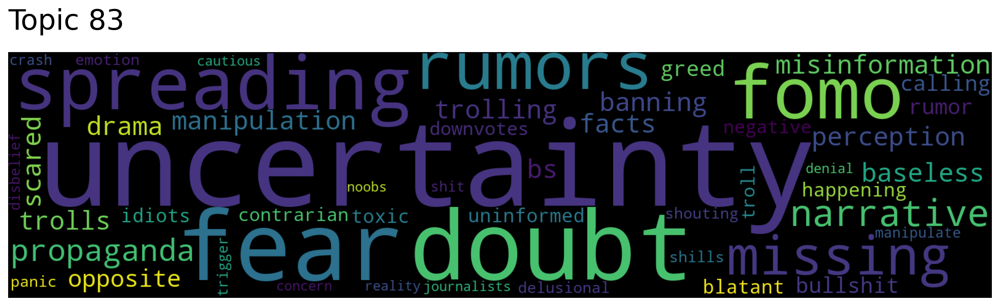

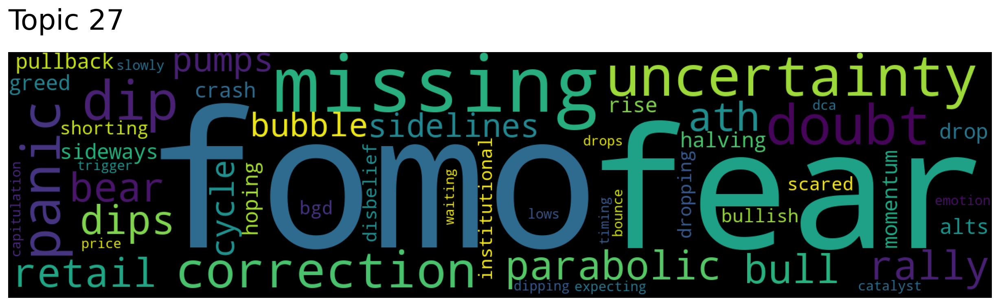

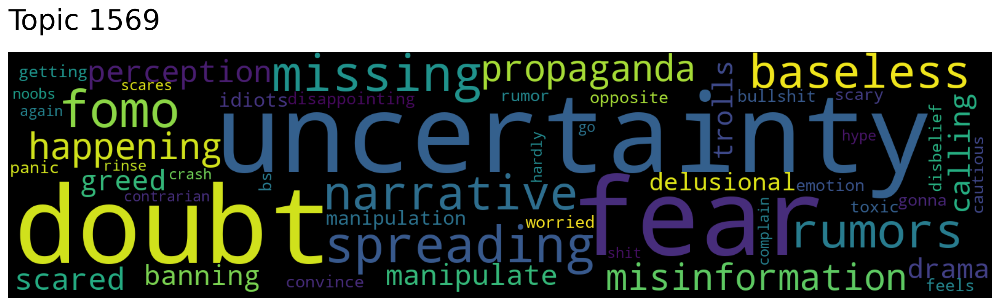

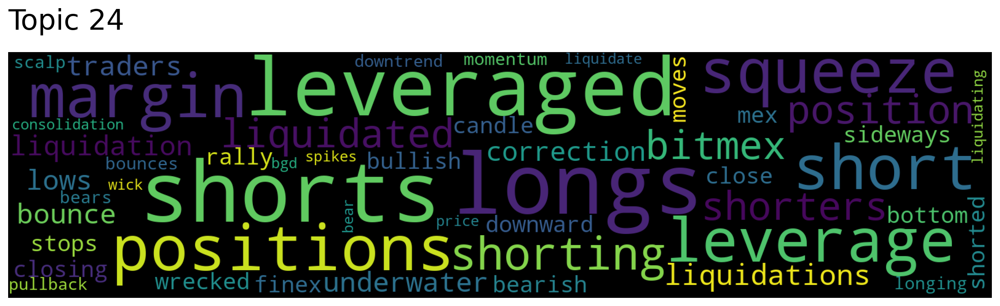

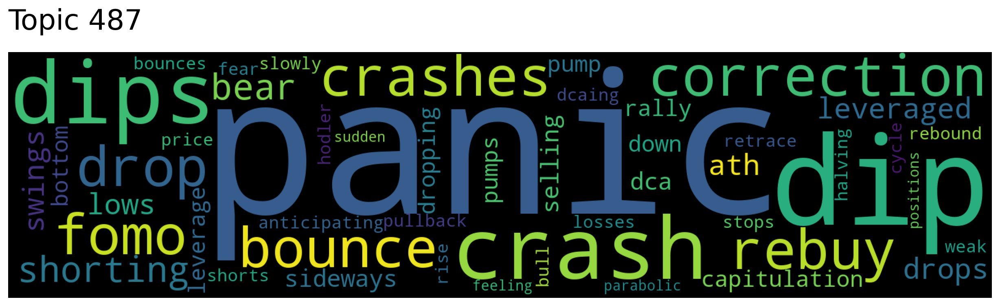

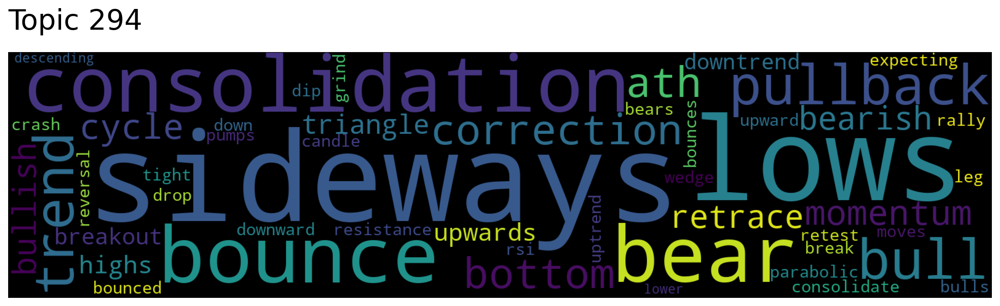

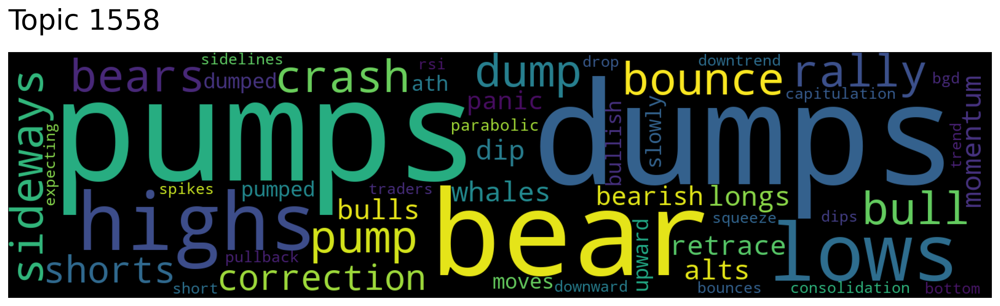

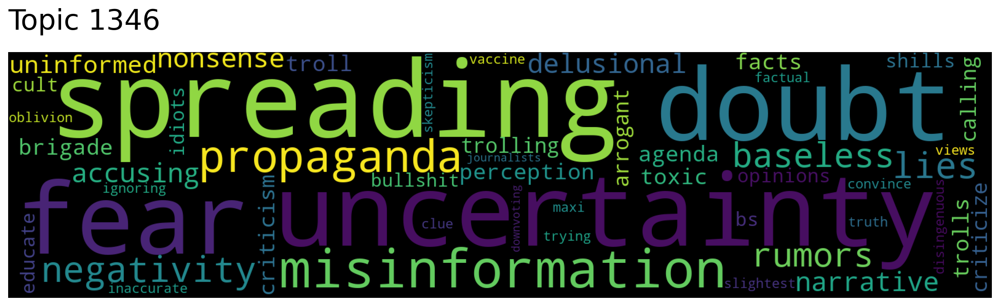

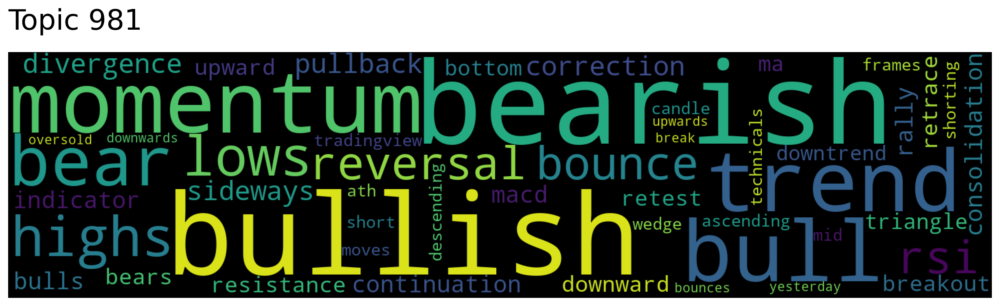

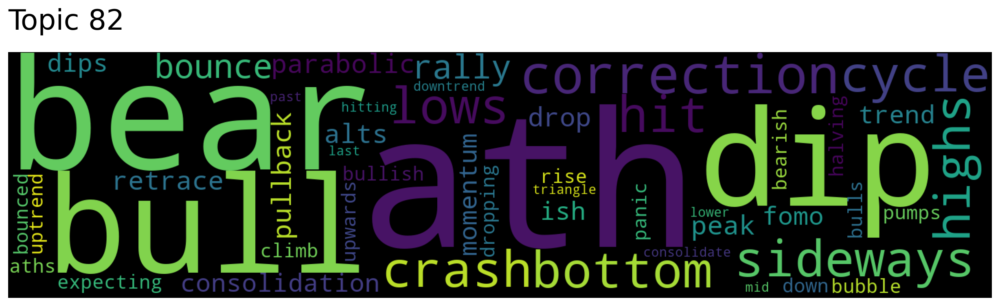

In [47]:
# Visualise in Word Clouds
for topic in topic_nums:
    t2v5_model.generate_topic_wordcloud(topic)

**Identify Topics Related to Policy Uncertainty**

In [48]:
topic_words, word_scores, topic_scores, topic_nums = t2v5_model.search_topics(
    keywords=["uncertainty", "policy"], num_topics=10
)

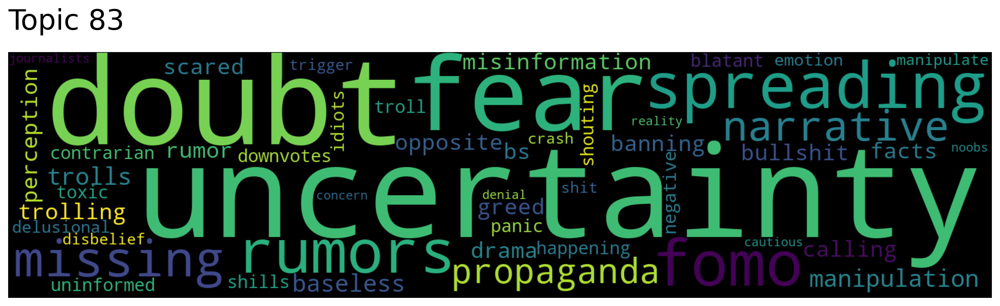

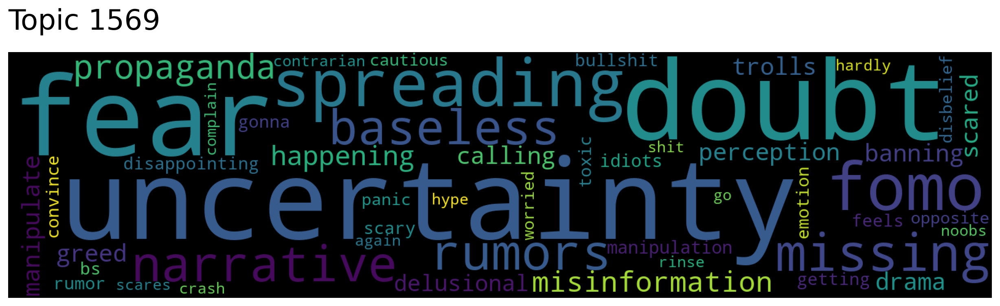

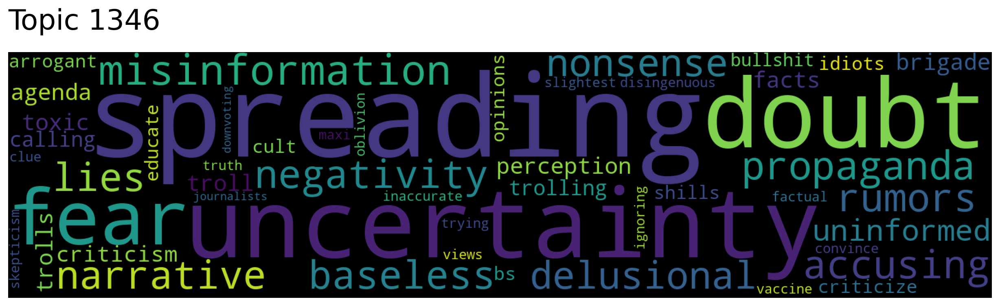

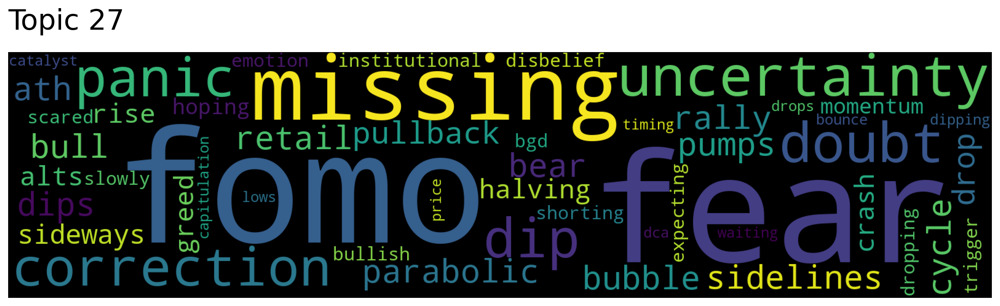

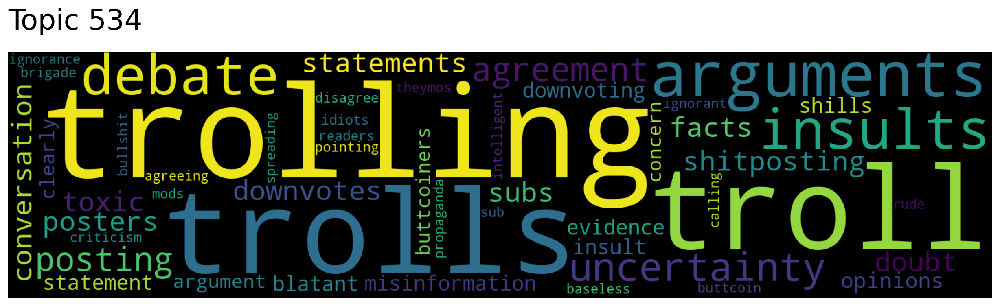

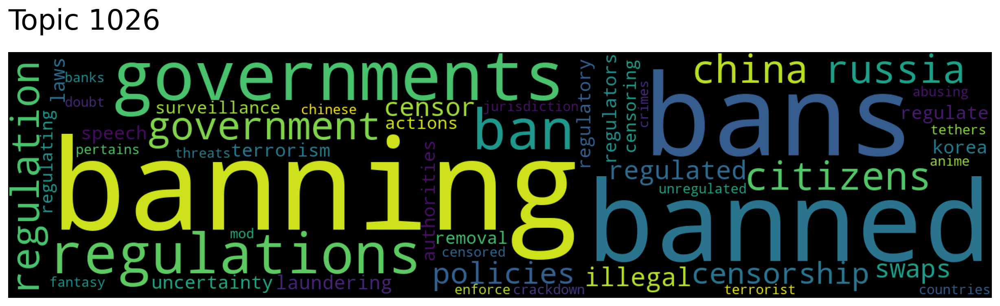

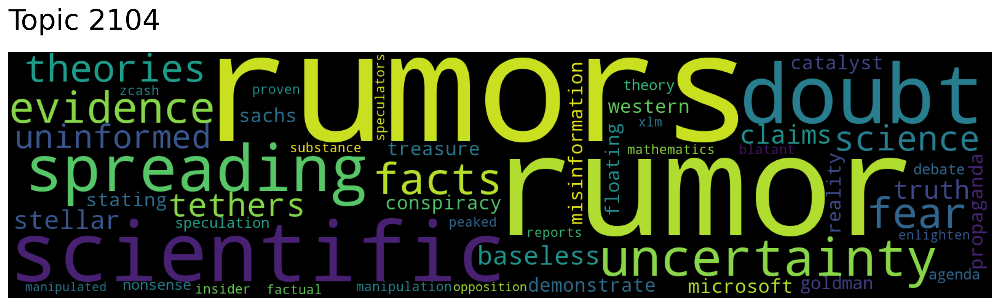

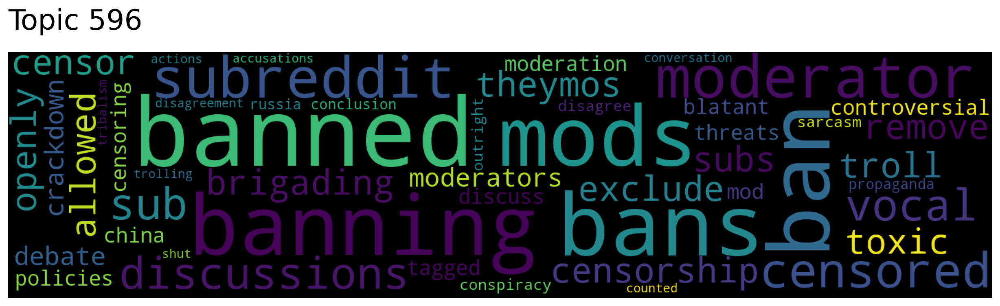

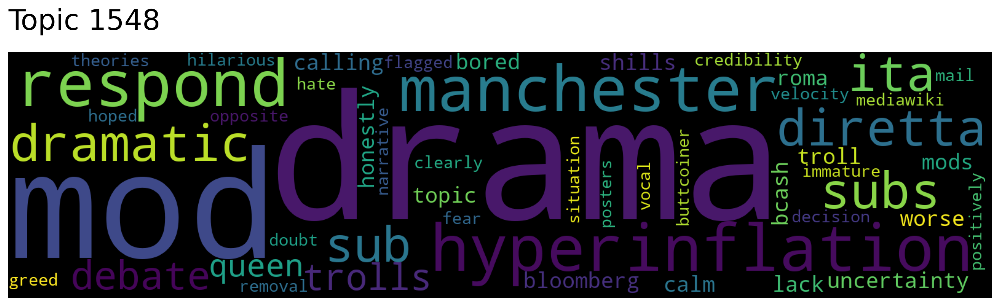

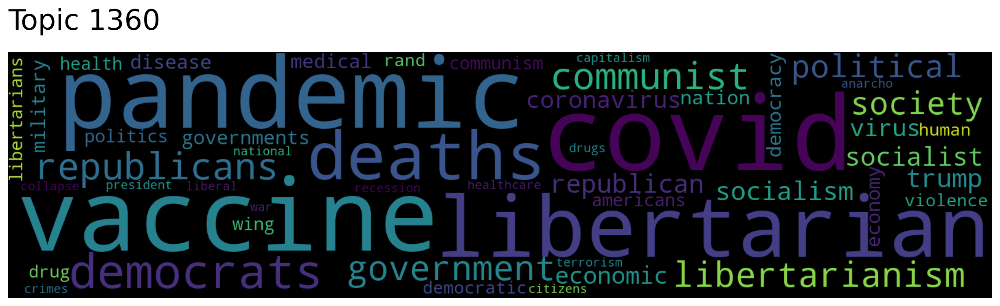

In [49]:
# Visualise in Word Clouds
for topic in topic_nums:
    t2v5_model.generate_topic_wordcloud(topic)

#### 2.2 Sampled Corpus (10%)

In [3]:
# 10% base
# t2v10_model = Top2Vec.load("nlp/topic_models/models/top2vec/top2vec_learn_doc2vec_10")

# 10% but with min cluster size = 50
# t2v10_model = Top2Vec.load("nlp/topic_models/models/top2vec/top2vec_learn_doc2vec_10_mcs_50")

# 10% but with min cluster size = 100 (TBD: Test out Top2Vec with MCS = 1000)
t2v10_model = Top2Vec.load("nlp/topic_models/models/top2vec/top2vec_learn_doc2vec_10_mcs_100")

In [4]:
print(f"Number of Topics: {t2v10_model.get_num_topics()}")

Number of Topics: 1623


**Identify Topics Related to Price Uncertainty**

In [5]:
topic_words, word_scores, topic_scores, topic_nums = t2v10_model.search_topics(
    keywords=["uncertainty", "price"], num_topics=10
)

In [6]:
# Pick relevant topics
topic_scores

array([0.48574061, 0.43041369, 0.34956955, 0.34876489, 0.33776576,
       0.32829006, 0.31907166, 0.31728566, 0.30660239, 0.30439778])

In [8]:
# Pick relevant words in relevant topics
list(zip(list(topic_words[0]), list(word_scores[0])))

[('uncertainty', 0.71825635),
 ('fear', 0.7101562),
 ('doubt', 0.65938693),
 ('spreading', 0.46648917),
 ('fomo', 0.4322971),
 ('narrative', 0.4081815),
 ('missing', 0.37311307),
 ('panic', 0.36988646),
 ('misinformation', 0.3599317),
 ('mongering', 0.35060695),
 ('disinformation', 0.33583173),
 ('manipulation', 0.3285485),
 ('baseless', 0.32577458),
 ('propaganda', 0.30446973),
 ('manipulate', 0.30068064),
 ('banning', 0.29851657),
 ('fudding', 0.29469386),
 ('trolls', 0.2821625),
 ('greed', 0.28175625),
 ('agenda', 0.28157565),
 ('orchestrated', 0.2803161),
 ('scare', 0.2750857),
 ('rumors', 0.27439237),
 ('trolling', 0.27242073),
 ('emotion', 0.26925704),
 ('negativity', 0.26654136),
 ('troll', 0.26517814),
 ('warranted', 0.26468202),
 ('blatant', 0.26238212),
 ('delusional', 0.2586116),
 ('opinions', 0.25819415),
 ('facts', 0.25737992),
 ('lies', 0.25737005),
 ('shills', 0.25721565),
 ('slightest', 0.25472695),
 ('nonsense', 0.25388166),
 ('truth', 0.2534137),
 ('perception', 0.249

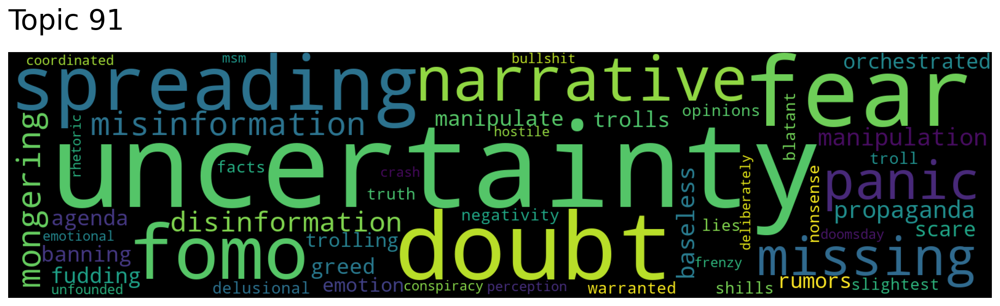

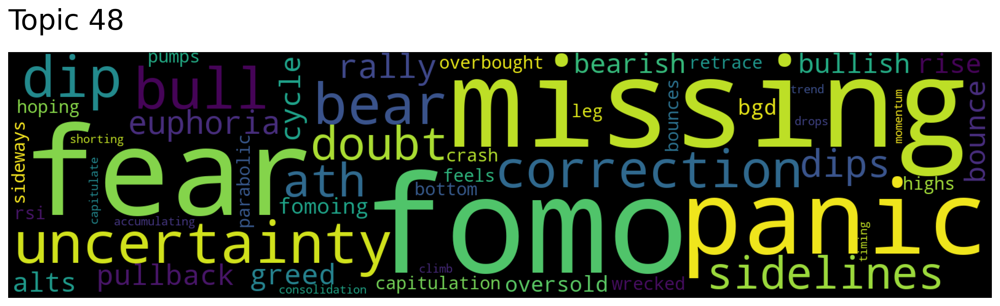

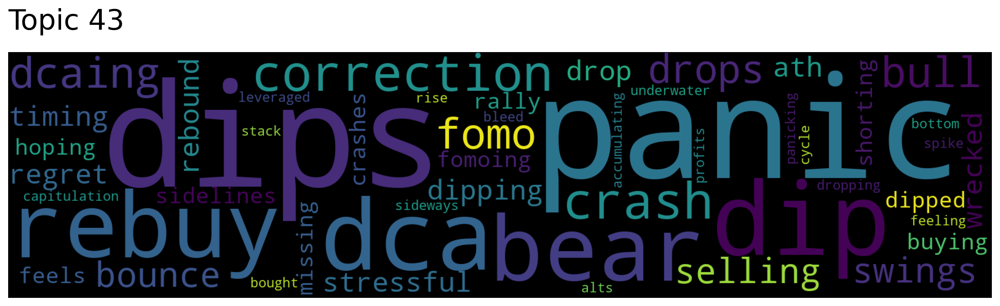

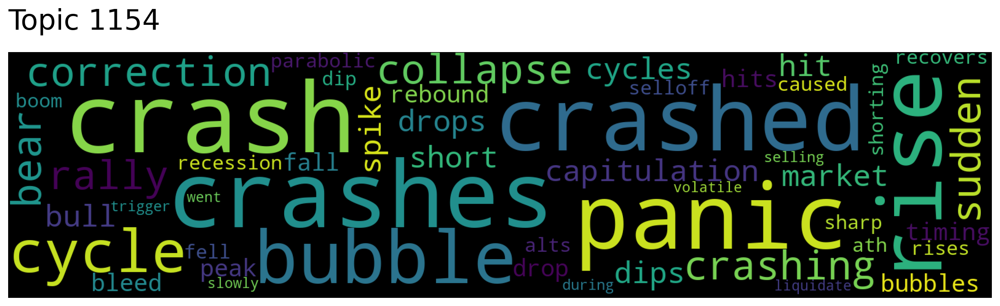

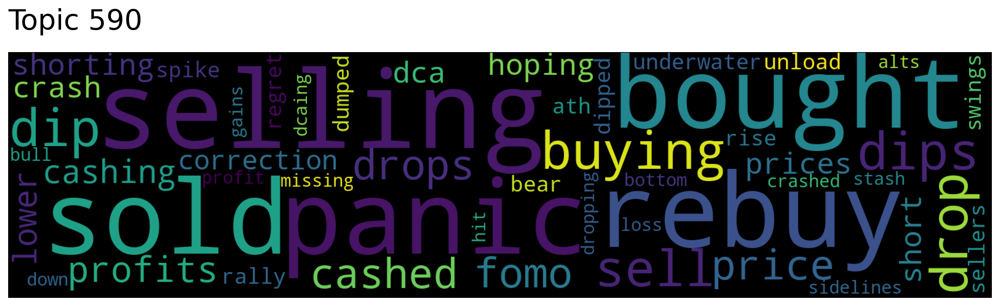

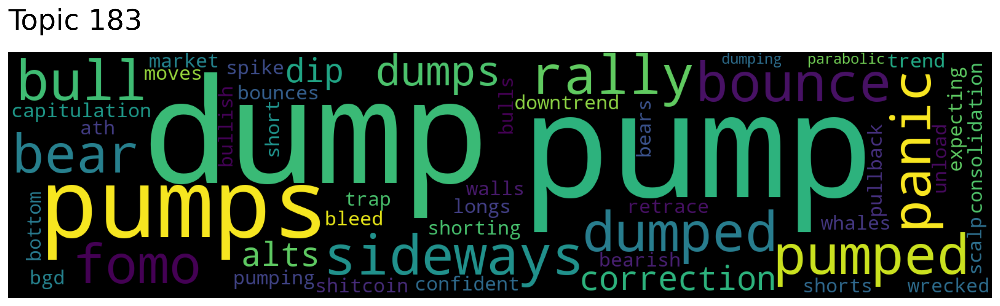

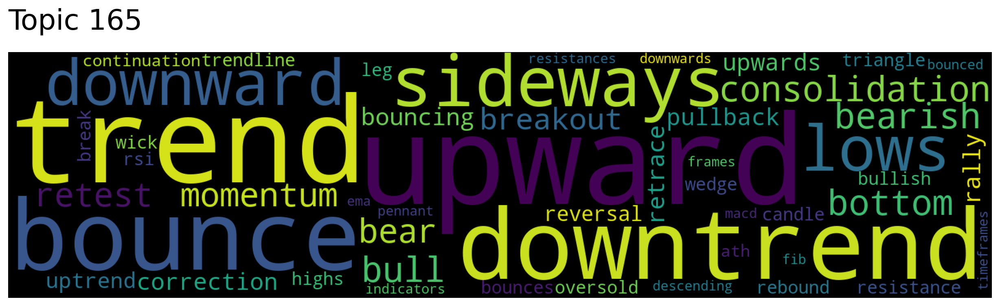

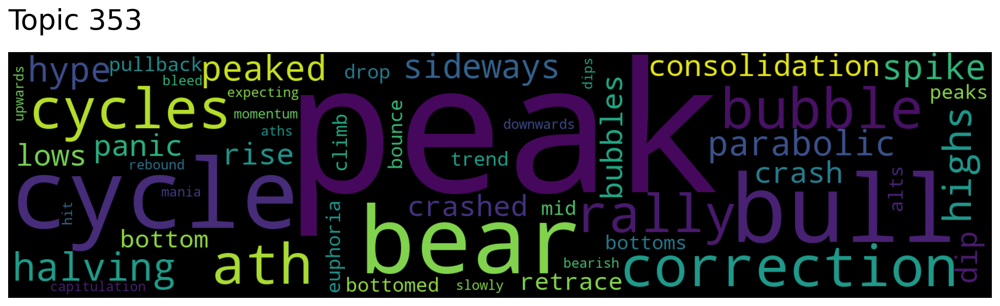

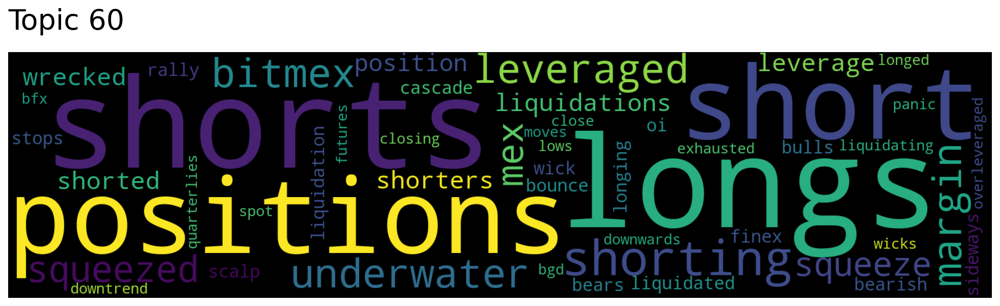

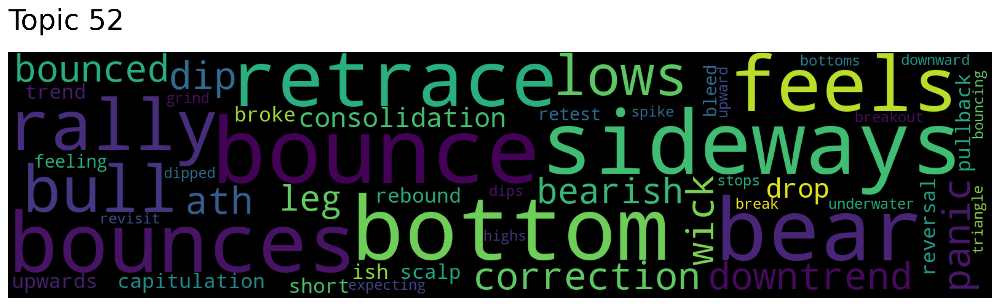

In [9]:
# Visualise in Word Clouds
for topic in topic_nums:
    t2v10_model.generate_topic_wordcloud(topic)

**Identify Topics Related to Policy Uncertainty**

In [10]:
topic_words, word_scores, topic_scores, topic_nums = t2v10_model.search_topics(
    keywords=["uncertainty", "policy"], num_topics=10
)

In [11]:
topic_scores

array([0.51264707, 0.34606509, 0.28757057, 0.263814  , 0.22674057,
       0.21936232, 0.21356412, 0.21276555, 0.21207438, 0.2102405 ])

In [12]:
# Pick relevant words in relevant topics
list(zip(list(topic_words[0]), list(word_scores[0])))

[('uncertainty', 0.71825635),
 ('fear', 0.7101562),
 ('doubt', 0.65938693),
 ('spreading', 0.46648917),
 ('fomo', 0.4322971),
 ('narrative', 0.4081815),
 ('missing', 0.37311307),
 ('panic', 0.36988646),
 ('misinformation', 0.3599317),
 ('mongering', 0.35060695),
 ('disinformation', 0.33583173),
 ('manipulation', 0.3285485),
 ('baseless', 0.32577458),
 ('propaganda', 0.30446973),
 ('manipulate', 0.30068064),
 ('banning', 0.29851657),
 ('fudding', 0.29469386),
 ('trolls', 0.2821625),
 ('greed', 0.28175625),
 ('agenda', 0.28157565),
 ('orchestrated', 0.2803161),
 ('scare', 0.2750857),
 ('rumors', 0.27439237),
 ('trolling', 0.27242073),
 ('emotion', 0.26925704),
 ('negativity', 0.26654136),
 ('troll', 0.26517814),
 ('warranted', 0.26468202),
 ('blatant', 0.26238212),
 ('delusional', 0.2586116),
 ('opinions', 0.25819415),
 ('facts', 0.25737992),
 ('lies', 0.25737005),
 ('shills', 0.25721565),
 ('slightest', 0.25472695),
 ('nonsense', 0.25388166),
 ('truth', 0.2534137),
 ('perception', 0.249

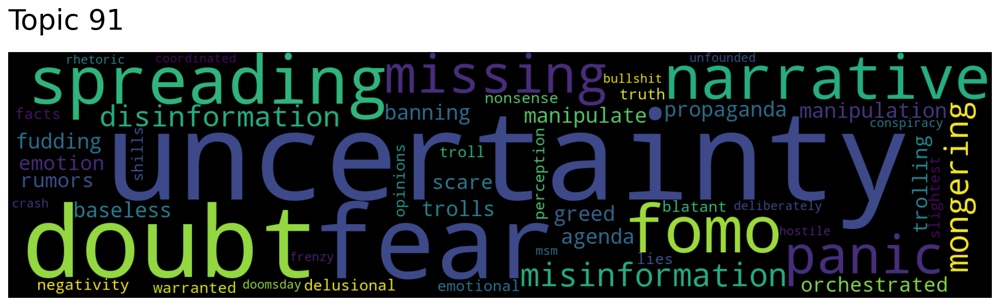

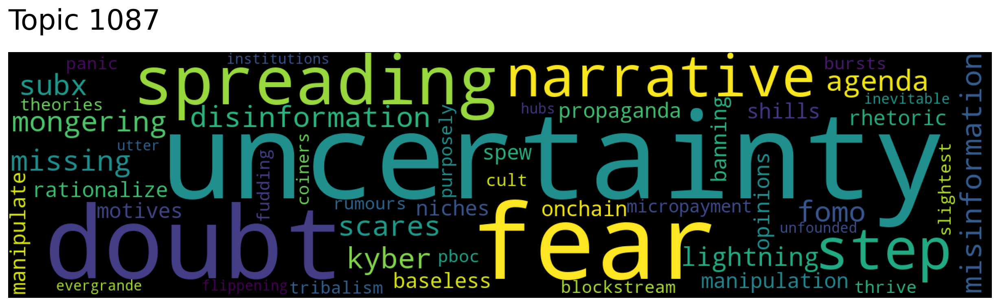

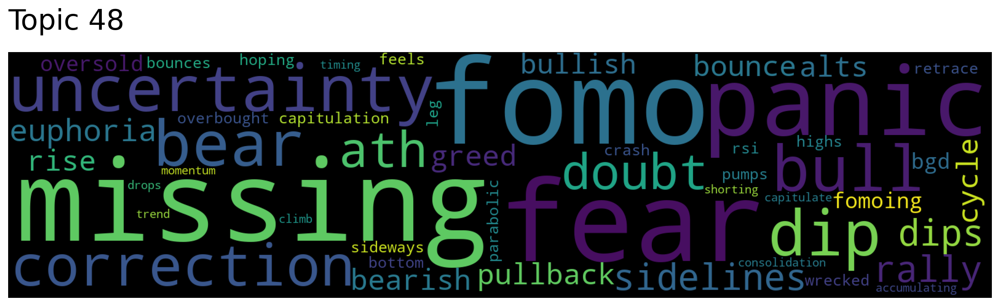

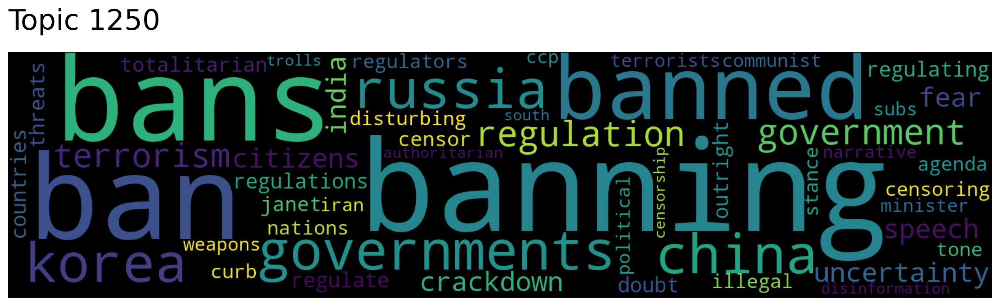

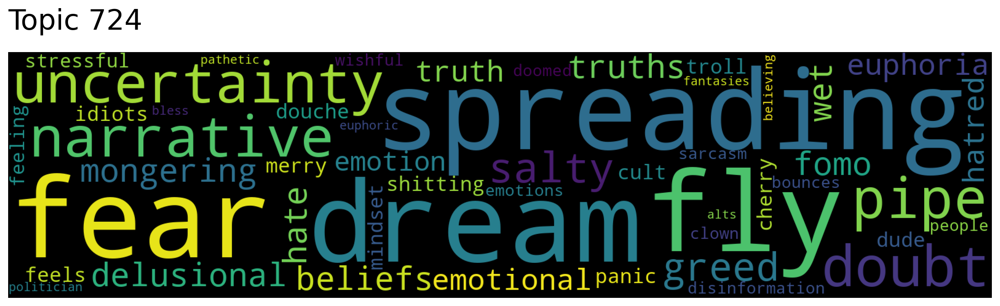

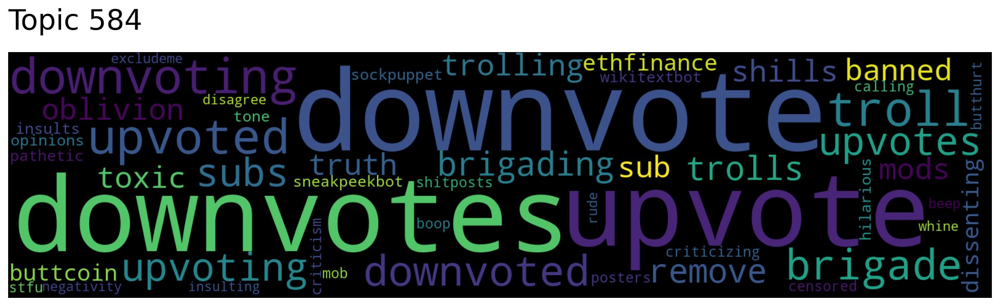

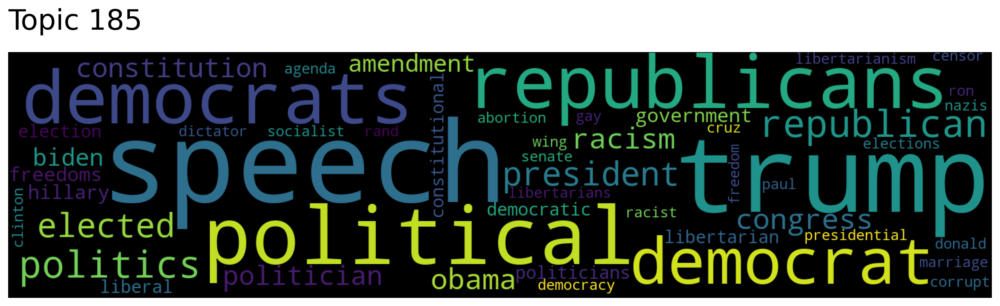

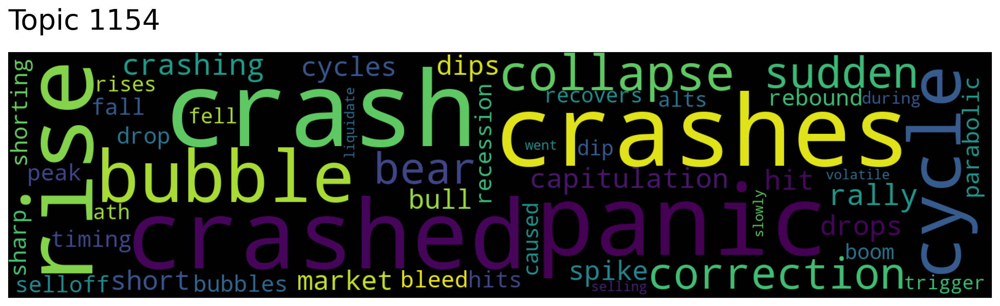

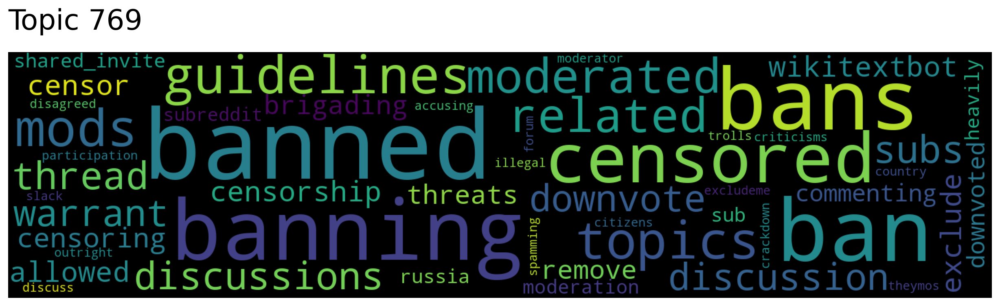

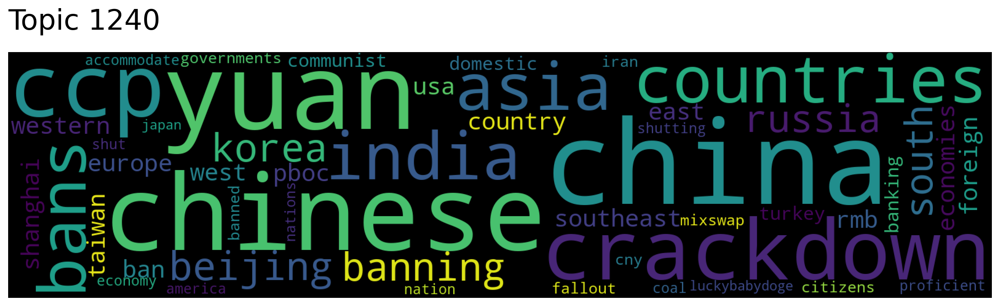

In [31]:
# Visualise in Word Clouds
for topic in topic_nums:
    t2v10_model.generate_topic_wordcloud(topic)